In [2]:
%cd /content/drive/MyDrive/ProGAN/
%load_ext tensorboard

%tensorboard --logdir logs

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
!python train.py

# Base Classification

In [3]:
!pip install torch==1.9.1

     |████████████████████████████████| 831.4 MB 5.0 kB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu111
    Uninstalling torch-1.9.0+cu111:
      Successfully uninstalled torch-1.9.0+cu111
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchvision 0.10.0+cu111 requires torch==1.9.0, but you have torch 1.9.1 which is incompatible.
torchtext 0.10.0 requires torch==1.9.0, but you have torch 1.9.1 which is incompatible.


In [4]:
import matplotlib.pyplot as plt
import numpy as np
import PIL
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as dset
from torch.utils.data.sampler import SubsetRandomSampler
import torch.nn.functional as F
import os
from torchvision import transforms
from sklearn.metrics import roc_curve, auc
import random

In [5]:
def my_seed_everywhere(seed: int = 42):
    random.seed(seed) # random
    np.random.seed(seed) # numpy
    os.environ["PYTHONHASHSEED"] = str(seed) # os
    # pytorch
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed) 
    torch.backends.cudnn.deterministic = True 
    torch.backends.cudnn.benchmark = False 

my_seed = 42
my_seed_everywhere(my_seed)

In [6]:
data_transforms = transforms.Compose([
            transforms.ToTensor(), 
            transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ])

In [ ]:
trainset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/train', 
                            transform=data_transforms)
testset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/test', 
                           transform=data_transforms)
print(len(trainset))
print(len(testset))
data_size = len(trainset.samples)
validation_split = .2
split = int(np.floor(validation_split * data_size))
indices = list(range(data_size))
np.random.shuffle(indices)
batch_size = 8
train_indices, val_indices = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_indices)
val_sampler = SubsetRandomSampler(val_indices)

train_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, 
                                           sampler=train_sampler)
val_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                         sampler=val_sampler)

test_loader = torch.utils.data.DataLoader(testset, batch_size=batch_size)

1197
660


In [7]:
class Flattener(nn.Module):
    def forward(self, x):
        batch_size, *_ = x.shape
        return x.view(batch_size, -1)

In [8]:
USE_GPU = True

if USE_GPU and torch.cuda.is_available():
    print('using device: cuda')
else:
    print('using device: cpu')

using device: cuda


In [9]:
def train_model(model, train_loader, val_loader, loss, optimizer, num_epochs):    
    loss_history = []
    train_history = []
    val_history = []
    

    for epoch in range(num_epochs):
        model.train() # Enter train mode
        
        loss_accum = 0
        correct_samples = 0
        total_samples = 0
        for i_step, (x, y) in enumerate(train_loader):
            
            x_gpu = x.to(device)
            y_gpu = y.to(device)
            prediction = model(x_gpu)    
            loss_value = loss(prediction, y_gpu)
            optimizer.zero_grad()
            loss_value.backward()
            optimizer.step()
            
            _, indices = torch.max(prediction, 1)
            correct_samples += torch.sum(indices == y_gpu)
            total_samples += y.shape[0]
            
            loss_accum += loss_value

        ave_loss = loss_accum / i_step
        train_accuracy = float(correct_samples) / total_samples
        val_accuracy = compute_accuracy(model, val_loader)
        
        loss_history.append(float(ave_loss))
        train_history.append(train_accuracy)
        val_history.append(val_accuracy)
        
        print(f"Average loss: {ave_loss}, \
            Train accuracy: {train_accuracy}, \
            Val accuracy: {val_accuracy}")
        
    return loss_history, train_history, val_history
        
def compute_accuracy(model, loader, auc=False):
    model.eval() 
    correct_samples = 0
    total_samples = 0
    y_true, y_pred = [], []
    for (x, y) in loader:
      
        x_gpu = x.to(device)
        y_gpu = y.to(device)
        prediction = model(x_gpu)    
        indices = torch.argmax(prediction, 1)
        fpr, tpr, _ = roc_curve(y_gpu.cpu().detach().numpy(), indices.cpu().detach().numpy())

        correct_samples += torch.sum(indices == y_gpu)
        total_samples += y_gpu.shape[0]
        accuracy = float(correct_samples) / total_samples
        torch.cuda.get_device_name(0)
        if auc:
            y_true.extend(y_gpu.cpu().detach().numpy())
            y_pred.extend(indices.cpu().detach().numpy())
    if auc:
        return accuracy, y_true, y_pred
    else: 
        return accuracy
    
    

    return accuracy, y_true, y_pred

def loss_accuracy_plot(loss_history, train_history, val_history):
    plt.figure(figsize=(10, 9))
    plt.subplot(311)
    # plt.ylim(bottom=0)
    plt.title("Loss")
    plt.plot(loss_history)
    plt.subplot(312)
    plt.ylim((.5, 1))
    plt.title("Train/validation accuracy")
    plt.plot(train_history, label="train")
    plt.plot(val_history, label="validation")

    plt.legend();

In [10]:
device = torch.device('cuda')
# torch.set_num_threads(16)
print(torch.cuda.get_device_name(0))
nn_model = nn.Sequential(
            nn.Conv2d(3, 64, 3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(4),
            nn.Conv2d(64, 64, 3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(24),    
            Flattener(),
            nn.Linear(64*2*2, 2),
          )
device = torch.device("cuda" if torch.cuda.is_available else "cpu")
nn_model.type(torch.cuda.FloatTensor)

nn_model.to(device)

loss = nn.CrossEntropyLoss().type(torch.cuda.FloatTensor)

# optimizer = optim.SGD(nn_model.parameters(), lr=1e-3, weight_decay=1e-4)
optimizer = optim.Adam(nn_model.parameters(), lr=0.001, 
                       betas=(0.9, 0.999), eps=1e-08, 
                       weight_decay=0.0001, amsgrad=False)

Tesla P100-PCIE-16GB


In [11]:
torch.__version__

'1.9.1+cu102'

Average loss: 0.47985801100730896,             Train accuracy: 0.7654028436018957,             Val accuracy: 0.8102466793168881
Average loss: 0.39502543210983276,             Train accuracy: 0.8004739336492891,             Val accuracy: 0.7798861480075902
Average loss: 0.3618961274623871,             Train accuracy: 0.8208530805687204,             Val accuracy: 0.8519924098671727
Average loss: 0.3477899432182312,             Train accuracy: 0.837914691943128,             Val accuracy: 0.8349146110056926


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.341470330953598,             Train accuracy: 0.837914691943128,             Val accuracy: 0.8614800759013282
Average loss: 0.3365338146686554,             Train accuracy: 0.8450236966824645,             Val accuracy: 0.857685009487666
Average loss: 0.31506556272506714,             Train accuracy: 0.8601895734597157,             Val accuracy: 0.8614800759013282


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.3006041646003723,             Train accuracy: 0.862085308056872,             Val accuracy: 0.855787476280835
Average loss: 0.2903081178665161,             Train accuracy: 0.8639810426540284,             Val accuracy: 0.8368121442125237
Average loss: 0.29229822754859924,             Train accuracy: 0.8597156398104265,             Val accuracy: 0.8690702087286527
Average loss: 0.2698015868663788,             Train accuracy: 0.8767772511848341,             Val accuracy: 0.8652751423149905
Average loss: 0.2537061870098114,             Train accuracy: 0.8772511848341232,             Val accuracy: 0.8406072106261859
Average loss: 0.24714048206806183,             Train accuracy: 0.8933649289099526,             Val accuracy: 0.8785578747628083
Average loss: 0.2489081770181656,             Train accuracy: 0.8933649289099526,             Val accuracy: 0.8349146110056926
Average loss: 0.22247107326984406,             Train accuracy: 0.904739336492891,             Val accuracy: 0.8

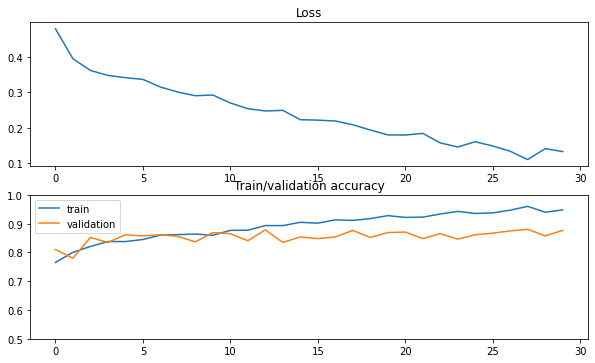

In [ ]:
loss_history, train_history, val_history = train_model(nn_model, 
                                                       train_loader, 
                                                       val_loader, 
                                                       loss, 
                                                       optimizer, 30)
loss_accuracy_plot(loss_history, train_history, val_history)
print('Finished!')

test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

In [ ]:
test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Final accuracy on the test set is: 0.8378787878787879; auc is: 0.8383333333333334


# Data_Augmentation

# Load library

In [3]:
%cd drive/MyDrive/ProGAN/
import torch
import torch.optim as optim
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
from utils import (
    gradient_penalty,
    plot_to_tensorboard,
    save_checkpoint,
    load_checkpoint,
    generate_examples,
)
from model import Discriminator, Generator
from math import log2
from tqdm import tqdm
import config
import os
import torchvision
import torch.nn as nn
import config
from torchvision.utils import save_image
from scipy.stats import truncnorm
import torch.utils.data.dataset as Dataset

/content/drive/MyDrive/ProGAN


In [4]:
def load_checkpoint(checkpoint_file, model, optimizer, lr):
    print("=> Loading checkpoint")
    checkpoint = torch.load(checkpoint_file, map_location="cuda")
    model.load_state_dict(checkpoint["state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer"])

    # If we don't do this then it will just have learning rate of old checkpoint
    # and it will lead to many hours of debugging \:
    for param_group in optimizer.param_groups:
        param_group["lr"] = lr

# Data Augmentation mal_200

In [5]:
gen = Generator(
        config.Z_DIM, config.IN_CHANNELS, img_channels=config.CHANNELS_IMG
    ).to(config.DEVICE)
opt_gen = optim.Adam(gen.parameters(), lr=config.LEARNING_RATE, betas=(0.0, 0.99))

In [6]:
load_checkpoint(
            '/content/drive/MyDrive/ProGAN/malignant_1300_samples/generator.pth', gen, opt_gen, config.LEARNING_RATE,
        )

=> Loading checkpoint


In [7]:
n = 64
steps = 6
truncation=0.7

In [10]:
gen.eval()
alpha = 1.0
for i in range(n):
    with torch.no_grad():
        noise = torch.tensor(truncnorm.rvs(-truncation, truncation, size=(1, config.Z_DIM, 1, 1)), device=config.DEVICE, dtype=torch.float32)
        img = gen(noise, alpha, steps)
        save_image(img*0.5+0.5, f"/content/drive/MyDrive/ProGAN/malignant_1300_samples/grid/sample_{i}.jpg")

# Classification mal200

In [32]:
data_transforms = transforms.Compose([
            transforms.Resize(224),
            transforms.ToTensor(), 
            transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ])

In [ ]:
trainset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/calssification/200', 
                            transform=data_transforms)
testset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/test', 
                           transform=data_transforms)
print(len(trainset))
print(len(testset))
data_size = len(trainset.samples)
validation_split = .2
split = int(np.floor(validation_split * data_size))
indices = list(range(data_size))
np.random.shuffle(indices)
batch_size = 8
train_indices, val_indices = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_indices)
val_sampler = SubsetRandomSampler(val_indices)

train_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, 
                                           sampler=train_sampler)
val_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                         sampler=val_sampler)

test_loader = torch.utils.data.DataLoader(testset, batch_size=batch_size)

KeyboardInterrupt: ignored

In [ ]:
Ddevice = torch.device('cuda')
# torch.set_num_threads(16)
print(torch.cuda.get_device_name(0))
nn_model = nn.Sequential(
            nn.Conv2d(3, 64, 3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(4),
            nn.Conv2d(64, 64, 3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(24),    
            Flattener(),
            nn.Linear(64*2*2, 2),
          )
device = torch.device("cuda" if torch.cuda.is_available else "cpu")
nn_model.type(torch.cuda.FloatTensor)

nn_model.to(device)

loss = nn.CrossEntropyLoss().type(torch.cuda.FloatTensor)

# optimizer = optim.SGD(nn_model.parameters(), lr=1e-3, weight_decay=1e-4)
optimizer = optim.Adam(nn_model.parameters(), lr=0.001, 
                       betas=(0.9, 0.999), eps=1e-08, 
                       weight_decay=0.0001, amsgrad=False)

Tesla P100-PCIE-16GB


Average loss: 0.3104860782623291,             Train accuracy: 0.8753554502369668,             Val accuracy: 0.9127134724857685
Average loss: 0.19820626080036163,             Train accuracy: 0.9279620853080569,             Val accuracy: 0.9108159392789373
Average loss: 0.1671193689107895,             Train accuracy: 0.9341232227488152,             Val accuracy: 0.9278937381404174


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.13015666604042053,             Train accuracy: 0.9473933649289099,             Val accuracy: 0.937381404174573
Average loss: 0.1344301998615265,             Train accuracy: 0.9440758293838862,             Val accuracy: 0.9278937381404174


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.12210473418235779,             Train accuracy: 0.9545023696682464,             Val accuracy: 0.9297912713472486
Average loss: 0.09173459559679031,             Train accuracy: 0.9620853080568721,             Val accuracy: 0.9411764705882353
Average loss: 0.10136061906814575,             Train accuracy: 0.9630331753554502,             Val accuracy: 0.9127134724857685
Average loss: 0.08733194321393967,             Train accuracy: 0.9606635071090047,             Val accuracy: 0.937381404174573
Average loss: 0.07220382988452911,             Train accuracy: 0.9701421800947867,             Val accuracy: 0.9316888045540797
Average loss: 0.061822447925806046,             Train accuracy: 0.9739336492890995,             Val accuracy: 0.9430740037950665
Average loss: 0.071135513484478,             Train accuracy: 0.9729857819905213,             Val accuracy: 0.9335863377609108
Average loss: 0.05618692561984062,             Train accuracy: 0.9805687203791469,             Val accurac

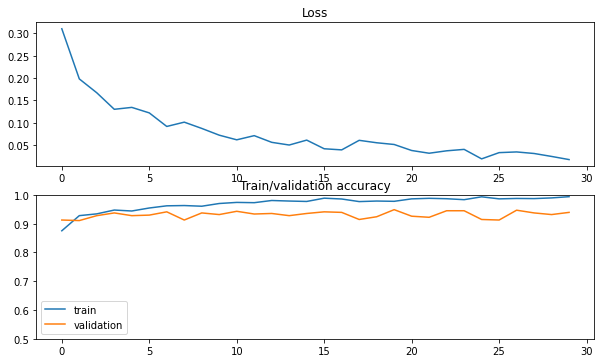

In [ ]:
loss_history, train_history, val_history = train_model(nn_model, 
                                                       train_loader, 
                                                       val_loader, 
                                                       loss, 
                                                       optimizer, 30)
loss_accuracy_plot(loss_history, train_history, val_history)
print('Finished!')

test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

In [ ]:
test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Final accuracy on the test set is: 0.7318181818181818; auc is: 0.711388888888889


# Data Augmentation mal100

In [ ]:
load_checkpoint(
            '/content/drive/MyDrive/ProGAN/malignant_100_samples/generator.pth', gen, opt_gen, config.LEARNING_RATE,
        )

=> Loading checkpoint


In [ ]:
n = 1097
steps = 6
truncation=0.7

In [ ]:
gen.eval()
alpha = 1.0
for i in range(n):
    with torch.no_grad():
        noise = torch.tensor(truncnorm.rvs(-truncation, truncation, size=(1, config.Z_DIM, 1, 1)), device=config.DEVICE, dtype=torch.float32)
        img = gen(noise, alpha, steps)
        save_image(img*0.5+0.5, f"/content/drive/MyDrive/ProGAN/all/calssification/100/malignant/sample_{i}.jpg")

# Classification mal100

In [ ]:
trainset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/calssification/100', 
                            transform=data_transforms)
testset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/test', 
                           transform=data_transforms)
print(len(trainset))
print(len(testset))
data_size = len(trainset.samples)
validation_split = .2
split = int(np.floor(validation_split * data_size))
indices = list(range(data_size))
np.random.shuffle(indices)
batch_size = 8
train_indices, val_indices = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_indices)
val_sampler = SubsetRandomSampler(val_indices)

train_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, 
                                           sampler=train_sampler)
val_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                         sampler=val_sampler)

test_loader = torch.utils.data.DataLoader(testset, batch_size=batch_size)

2637
660


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.2656945586204529,             Train accuracy: 0.8981042654028436,             Val accuracy: 0.9753320683111955
Average loss: 0.13318954408168793,             Train accuracy: 0.9578199052132701,             Val accuracy: 0.967741935483871
Average loss: 0.12171620875597,             Train accuracy: 0.9554502369668246,             Val accuracy: 0.969639468690702
Average loss: 0.09107354283332825,             Train accuracy: 0.9706161137440759,             Val accuracy: 0.9601518026565465


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.08483531326055527,             Train accuracy: 0.9710900473933649,             Val accuracy: 0.969639468690702
Average loss: 0.07364215701818466,             Train accuracy: 0.9715639810426541,             Val accuracy: 0.9715370018975332
Average loss: 0.08251933008432388,             Train accuracy: 0.9706161137440759,             Val accuracy: 0.9753320683111955
Average loss: 0.07656460255384445,             Train accuracy: 0.9729857819905213,             Val accuracy: 0.9620493358633776
Average loss: 0.06785181909799576,             Train accuracy: 0.9767772511848342,             Val accuracy: 0.969639468690702
Average loss: 0.0433478020131588,             Train accuracy: 0.9800947867298578,             Val accuracy: 0.9753320683111955
Average loss: 0.05200204625725746,             Train accuracy: 0.9805687203791469,             Val accuracy: 0.9753320683111955
Average loss: 0.04897192120552063,             Train accuracy: 0.9805687203791469,             Val accuracy

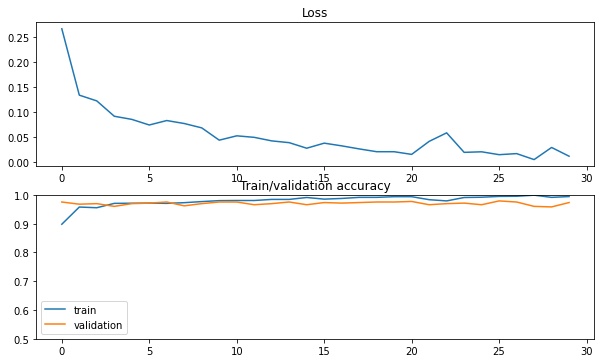

In [ ]:
loss_history, train_history, val_history = train_model(nn_model, 
                                                       train_loader, 
                                                       val_loader, 
                                                       loss, 
                                                       optimizer, 30)
loss_accuracy_plot(loss_history, train_history, val_history)
print('Finished!')

test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

In [ ]:
test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Final accuracy on the test set is: 0.6136363636363636; auc is: 0.5783333333333333


# Data Augmentation mal 50


In [15]:
gen = Generator(
        config.Z_DIM, config.IN_CHANNELS, img_channels=config.CHANNELS_IMG
    ).to(config.DEVICE)
opt_gen = optim.Adam(gen.parameters(), lr=config.LEARNING_RATE, betas=(0.0, 0.99))

In [ ]:
load_checkpoint(
            '/content/drive/MyDrive/ProGAN/malignant_50_samples/generator.pth', gen, opt_gen, config.LEARNING_RATE,
        )

=> Loading checkpoint


In [ ]:
n = 1147
steps = 6
truncation=0.7

In [ ]:
gen.eval()
alpha = 1.0
for i in range(n):
    with torch.no_grad():
        noise = torch.tensor(truncnorm.rvs(-truncation, truncation, size=(1, config.Z_DIM, 1, 1)), device=config.DEVICE, dtype=torch.float32)
        img = gen(noise, alpha, steps)
        save_image(img*0.5+0.5, f"/content/drive/MyDrive/ProGAN/malignant_50_samples/grid/sample_{i}.jpg")

# Classification mal 50

In [ ]:
trainset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/calssification/50', 
                            transform=data_transforms)
testset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/test', 
                           transform=data_transforms)
print(len(trainset))
print(len(testset))
data_size = len(trainset.samples)
validation_split = .2
split = int(np.floor(validation_split * data_size))
indices = list(range(data_size))
np.random.shuffle(indices)
batch_size = 8
train_indices, val_indices = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_indices)
val_sampler = SubsetRandomSampler(val_indices)

train_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, 
                                           sampler=train_sampler)
val_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                         sampler=val_sampler)

test_loader = torch.utils.data.DataLoader(testset, batch_size=batch_size)

2637
660


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.10613839328289032,             Train accuracy: 0.9620853080568721,             Val accuracy: 0.9791271347248577
Average loss: 0.07884380966424942,             Train accuracy: 0.9786729857819905,             Val accuracy: 0.9791271347248577
Average loss: 0.0694291964173317,             Train accuracy: 0.9786729857819905,             Val accuracy: 0.9791271347248577
Average loss: 0.061571910977363586,             Train accuracy: 0.9824644549763033,             Val accuracy: 0.967741935483871
Average loss: 0.06039908155798912,             Train accuracy: 0.9815165876777251,             Val accuracy: 0.9791271347248577
Average loss: 0.06021498143672943,             Train accuracy: 0.9815165876777251,             Val accuracy: 0.9772296015180265
Average loss: 0.05394085496664047,             Train accuracy: 0.9829383886255925,             Val accuracy: 0.9772296015180265
Average loss: 0.05660248175263405,             Train accuracy: 0.9829383886255925,             Val accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.04362834617495537,             Train accuracy: 0.9862559241706161,             Val accuracy: 0.9810246679316889
Average loss: 0.04314185678958893,             Train accuracy: 0.9872037914691943,             Val accuracy: 0.9829222011385199
Average loss: 0.04284057393670082,             Train accuracy: 0.9876777251184834,             Val accuracy: 0.9810246679316889
Average loss: 0.03693158179521561,             Train accuracy: 0.9890995260663508,             Val accuracy: 0.9829222011385199
Average loss: 0.029794760048389435,             Train accuracy: 0.9914691943127962,             Val accuracy: 0.967741935483871
Average loss: 0.046918246895074844,             Train accuracy: 0.9872037914691943,             Val accuracy: 0.9810246679316889
Average loss: 0.026570411399006844,             Train accuracy: 0.9919431279620853,             Val accuracy: 0.9791271347248577
Average loss: 0.029709478840231895,             Train accuracy: 0.9895734597156398,             Val ac

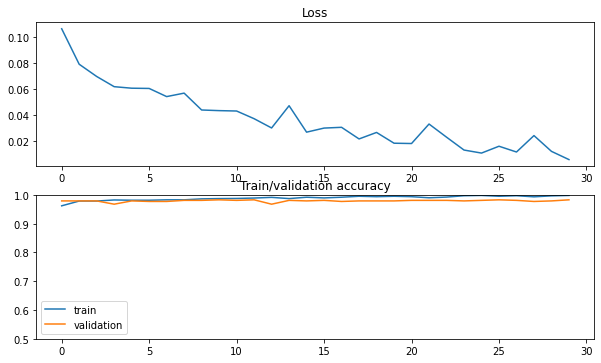

In [ ]:
loss_history, train_history, val_history = train_model(nn_model, 
                                                       train_loader, 
                                                       val_loader, 
                                                       loss, 
                                                       optimizer, 30)
loss_accuracy_plot(loss_history, train_history, val_history)
print('Finished!')

test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

# 추가학습

## Data Augmentation mal 300

In [16]:
load_checkpoint(
            '/content/drive/MyDrive/ProGAN/generator.pth', gen, opt_gen, config.LEARNING_RATE,
        )

=> Loading checkpoint


In [17]:
n = 897
steps = 6
truncation=0.7

In [19]:
gen.eval()
alpha = 1.0
for i in range(n):
    with torch.no_grad():
        noise = torch.tensor(truncnorm.rvs(-truncation, truncation, size=(1, config.Z_DIM, 1, 1)), device=config.DEVICE, dtype=torch.float32)
        img = gen(noise, alpha, steps)
        save_image(img*0.5+0.5, f"/content/drive/MyDrive/ProGAN/all/calssification/300/malignant/sample_{i}.jpg")

## Classification mal300

In [34]:
trainset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/calssification/300', 
                            transform=data_transforms)
testset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/test', 
                           transform=data_transforms)
print(len(trainset))
print(len(testset))
data_size = len(trainset.samples)
validation_split = .2
split = int(np.floor(validation_split * data_size))
indices = list(range(data_size))
np.random.shuffle(indices)
batch_size = 8
train_indices, val_indices = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_indices)
val_sampler = SubsetRandomSampler(val_indices)

train_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, 
                                           sampler=train_sampler)
val_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                         sampler=val_sampler)

test_loader = torch.utils.data.DataLoader(testset, batch_size=batch_size)

2637
660


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.3657090961933136,             Train accuracy: 0.8341232227488151,             Val accuracy: 0.8804554079696395


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.22679638862609863,             Train accuracy: 0.9037914691943127,             Val accuracy: 0.9146110056925996
Average loss: 0.20462043583393097,             Train accuracy: 0.9142180094786729,             Val accuracy: 0.9297912713472486
Average loss: 0.17782485485076904,             Train accuracy: 0.9218009478672986,             Val accuracy: 0.9184060721062619
Average loss: 0.18112562596797943,             Train accuracy: 0.9232227488151659,             Val accuracy: 0.9278937381404174
Average loss: 0.14866644144058228,             Train accuracy: 0.9379146919431279,             Val accuracy: 0.9240986717267552
Average loss: 0.14669030904769897,             Train accuracy: 0.9393364928909953,             Val accuracy: 0.937381404174573
Average loss: 0.1446468085050583,             Train accuracy: 0.9388625592417061,             Val accuracy: 0.9127134724857685
Average loss: 0.13183528184890747,             Train accuracy: 0.9379146919431279,             Val accurac

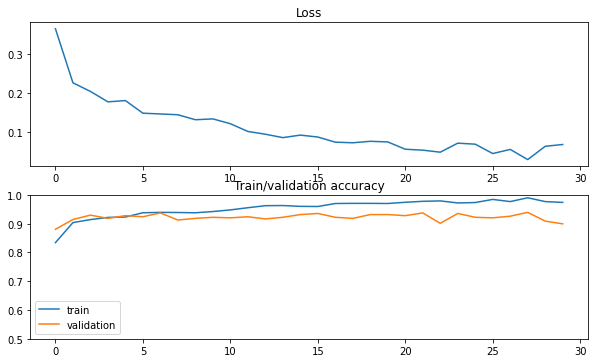

In [35]:
loss_history, train_history, val_history = train_model(nn_model, 
                                                       train_loader, 
                                                       val_loader, 
                                                       loss, 
                                                       optimizer, 30)
loss_accuracy_plot(loss_history, train_history, val_history)
print('Finished!')

test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

## Data Augmentation mal250

In [38]:
load_checkpoint(
            '/content/drive/MyDrive/ProGAN/malignant_250_samples/generator.pth', gen, opt_gen, config.LEARNING_RATE,
        )

=> Loading checkpoint


In [54]:
n = 947
steps = 6
truncation=0.7

In [55]:
gen.eval()
alpha = 1.0
for i in range(n):
    with torch.no_grad():
        noise = torch.tensor(truncnorm.rvs(-truncation, truncation, size=(1, config.Z_DIM, 1, 1)), device=config.DEVICE, dtype=torch.float32)
        img = gen(noise, alpha, steps)
        save_image(img*0.5+0.5, f"/content/drive/MyDrive/ProGAN/all/calssification/250/malignant/sample_{i}.jpg")

## Classification mal250

In [56]:
trainset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/calssification/250', 
                            transform=data_transforms)
testset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/test', 
                           transform=data_transforms)
print(len(trainset))
print(len(testset))
data_size = len(trainset.samples)
validation_split = .2
split = int(np.floor(validation_split * data_size))
indices = list(range(data_size))
np.random.shuffle(indices)
batch_size = 8
train_indices, val_indices = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_indices)
val_sampler = SubsetRandomSampler(val_indices)

train_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, 
                                           sampler=train_sampler)
val_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                         sampler=val_sampler)

test_loader = torch.utils.data.DataLoader(testset, batch_size=batch_size)

2637
660


Average loss: 0.12361929565668106,             Train accuracy: 0.9540284360189574,             Val accuracy: 0.9506641366223909


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.10256224125623703,             Train accuracy: 0.9635071090047393,             Val accuracy: 0.9582542694497154
Average loss: 0.05822077766060829,             Train accuracy: 0.9805687203791469,             Val accuracy: 0.9753320683111955
Average loss: 0.042807597666978836,             Train accuracy: 0.9838862559241706,             Val accuracy: 0.9601518026565465
Average loss: 0.03340750187635422,             Train accuracy: 0.9881516587677726,             Val accuracy: 0.9734345351043643
Average loss: 0.034529909491539,             Train accuracy: 0.9867298578199052,             Val accuracy: 0.9658444022770398
Average loss: 0.03871504217386246,             Train accuracy: 0.9843601895734597,             Val accuracy: 0.9620493358633776
Average loss: 0.06268399953842163,             Train accuracy: 0.9796208530805687,             Val accuracy: 0.9506641366223909
Average loss: 0.04113246127963066,             Train accuracy: 0.9853080568720379,             Val accura

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.023737596347928047,             Train accuracy: 0.9919431279620853,             Val accuracy: 0.9506641366223909
Average loss: 0.029853224754333496,             Train accuracy: 0.9890995260663508,             Val accuracy: 0.9544592030360531
Average loss: 0.0401364229619503,             Train accuracy: 0.9838862559241706,             Val accuracy: 0.9620493358633776
Average loss: 0.03417360410094261,             Train accuracy: 0.9876777251184834,             Val accuracy: 0.9316888045540797
Average loss: 0.04217195883393288,             Train accuracy: 0.9834123222748815,             Val accuracy: 0.9620493358633776
Average loss: 0.0431203655898571,             Train accuracy: 0.9853080568720379,             Val accuracy: 0.9487666034155597
Average loss: 0.036239802837371826,             Train accuracy: 0.9876777251184834,             Val accuracy: 0.9487666034155597
Average loss: 0.03643995150923729,             Train accuracy: 0.9867298578199052,             Val accu

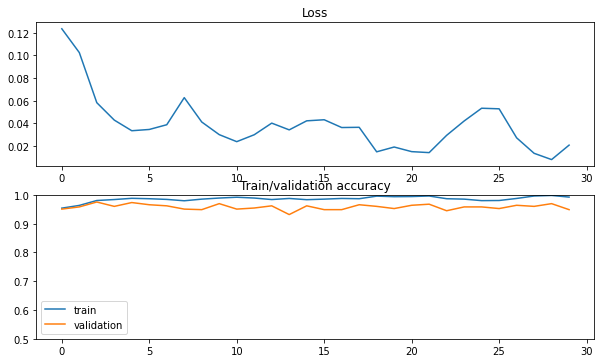

In [57]:
loss_history, train_history, val_history = train_model(nn_model, 
                                                       train_loader, 
                                                       val_loader, 
                                                       loss, 
                                                       optimizer, 30)
loss_accuracy_plot(loss_history, train_history, val_history)
print('Finished!')

test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

## Data Augmentation mal500

In [ ]:
load_checkpoint(
            '/content/drive/MyDrive/ProGAN/generator.pth', gen, opt_gen, config.LEARNING_RATE,
        )

=> Loading checkpoint


In [ ]:
n = 697
steps = 6
truncation=0.7

In [ ]:
gen.eval()
alpha = 1.0
for i in range(n):
    with torch.no_grad():
        noise = torch.tensor(truncnorm.rvs(-truncation, truncation, size=(1, config.Z_DIM, 1, 1)), device=config.DEVICE, dtype=torch.float32)
        img = gen(noise, alpha, steps)
        save_image(img*0.5+0.5, f"/content/drive/MyDrive/ProGAN/all/calssification/500/malignant/sample_{i}.jpg")

## Classification mal500

In [ ]:
trainset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/calssification/500', 
                            transform=data_transforms)
testset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/test', 
                           transform=data_transforms)
print(len(trainset))
print(len(testset))
data_size = len(trainset.samples)
validation_split = .2
split = int(np.floor(validation_split * data_size))
indices = list(range(data_size))
np.random.shuffle(indices)
batch_size = 8
train_indices, val_indices = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_indices)
val_sampler = SubsetRandomSampler(val_indices)

train_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, 
                                           sampler=train_sampler)
val_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                         sampler=val_sampler)

test_loader = torch.utils.data.DataLoader(testset, batch_size=batch_size)

2637
660


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.4188458323478699,             Train accuracy: 0.7990521327014218,             Val accuracy: 0.6888045540796964
Average loss: 0.3188779950141907,             Train accuracy: 0.8502369668246446,             Val accuracy: 0.8690702087286527
Average loss: 0.2729813754558563,             Train accuracy: 0.875829383886256,             Val accuracy: 0.8804554079696395
Average loss: 0.24622678756713867,             Train accuracy: 0.8876777251184834,             Val accuracy: 0.8747628083491461
Average loss: 0.25265559554100037,             Train accuracy: 0.890521327014218,             Val accuracy: 0.8747628083491461


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.2341027408838272,             Train accuracy: 0.904739336492891,             Val accuracy: 0.8785578747628083
Average loss: 0.21660876274108887,             Train accuracy: 0.9028436018957346,             Val accuracy: 0.905123339658444
Average loss: 0.19619759917259216,             Train accuracy: 0.9146919431279621,             Val accuracy: 0.8633776091081594
Average loss: 0.17963610589504242,             Train accuracy: 0.9232227488151659,             Val accuracy: 0.8804554079696395
Average loss: 0.1702931970357895,             Train accuracy: 0.9265402843601895,             Val accuracy: 0.8918406072106262
Average loss: 0.14961396157741547,             Train accuracy: 0.9364928909952607,             Val accuracy: 0.8861480075901328
Average loss: 0.15783821046352386,             Train accuracy: 0.933175355450237,             Val accuracy: 0.8785578747628083
Average loss: 0.13173872232437134,             Train accuracy: 0.9502369668246445,             Val accuracy: 

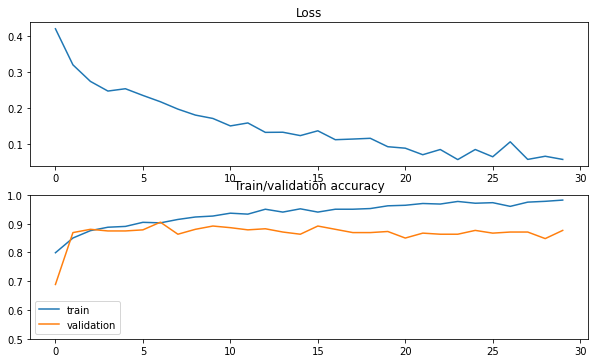

In [ ]:
loss_history, train_history, val_history = train_model(nn_model, 
                                                       train_loader, 
                                                       val_loader, 
                                                       loss, 
                                                       optimizer, 30)
loss_accuracy_plot(loss_history, train_history, val_history)
print('Finished!')

test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

In [ ]:
test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Final accuracy on the test set is: 0.8106060606060606; auc is: 0.8058333333333334


## Classification Mal 500 vs Bengign 1400 

In [ ]:
data_transforms = transforms.Compose([
            transforms.Resize(224),
            transforms.ToTensor(), 
            transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ])

In [ ]:
trainset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/extracted/500', 
                            transform=data_transforms)
testset = dset.ImageFolder('/content/drive/MyDrive/ProGAN/all/test', 
                           transform=data_transforms)
print(len(trainset))
print(len(testset))
data_size = len(trainset.samples)
validation_split = .2
split = int(np.floor(validation_split * data_size))
indices = list(range(data_size))
np.random.shuffle(indices)
batch_size = 8
train_indices, val_indices = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_indices)
val_sampler = SubsetRandomSampler(val_indices)

train_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, 
                                           sampler=train_sampler)
val_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                         sampler=val_sampler)

test_loader = torch.utils.data.DataLoader(testset, batch_size=batch_size)

1940
660


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:808: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


Average loss: 0.20502501726150513,             Train accuracy: 0.9233247422680413,             Val accuracy: 0.9329896907216495
Average loss: 0.17128245532512665,             Train accuracy: 0.9271907216494846,             Val accuracy: 0.9201030927835051
Average loss: 0.14118823409080505,             Train accuracy: 0.9452319587628866,             Val accuracy: 0.9381443298969072
Average loss: 0.11120310425758362,             Train accuracy: 0.9568298969072165,             Val accuracy: 0.9123711340206185
Average loss: 0.053867556154727936,             Train accuracy: 0.9826030927835051,             Val accuracy: 0.9458762886597938
Average loss: 0.050144847482442856,             Train accuracy: 0.979381443298969,             Val accuracy: 0.9355670103092784
Average loss: 0.09804423153400421,             Train accuracy: 0.961340206185567,             Val accuracy: 0.9252577319587629
Average loss: 0.08059124648571014,             Train accuracy: 0.9664948453608248,             Val accur

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_ranking.py:800: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


Final accuracy on the test set is: 0.8121212121212121; auc is: 0.81


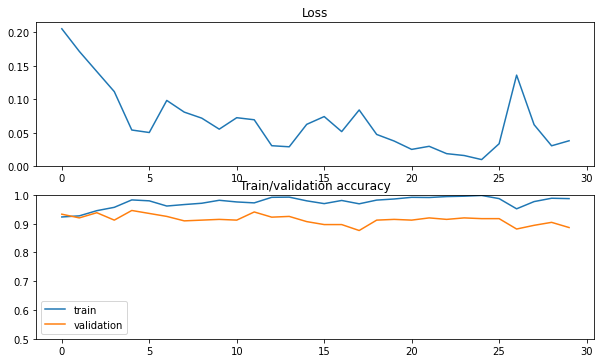

In [ ]:
loss_history, train_history, val_history = train_model(nn_model, 
                                                       train_loader, 
                                                       val_loader, 
                                                       loss, 
                                                       optimizer, 30)
loss_accuracy_plot(loss_history, train_history, val_history)
print('Finished!')

test_accuracy, y_true, y_pred = compute_accuracy(nn_model, test_loader, auc=True)

fpr, tpr, _ = roc_curve(y_true, y_pred)
auc_rate = auc(fpr, tpr)


print(f'Final accuracy on the test set is: {test_accuracy}; auc is: {auc_rate}')

# Grid 만들기

## 500


In [ ]:
root_dir = '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid'
img_path_list = []
possible_img_extension = ['.jpg', '.jpeg', '.JPG', '.bmp', '.png'] # 이미지 확장자들
 
for (root, dirs, files) in os.walk(root_dir):
    if len(files) > 0:
        for file_name in files:
            if os.path.splitext(file_name)[1] in possible_img_extension:
                img_path = root + '/' + file_name
                
                # 경로에서 \를 모두 /로 바꿔줘야함
                img_path = img_path.replace('\\', '/') # \는 \\로 나타내야함         
                img_path_list.append(img_path)
                             
print(img_path_list)

['/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_0.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_1.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_2.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_3.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_4.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_5.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_6.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_7.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_8.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_9.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_10.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_11.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_samples/grid/sample_12.jpg', '/content/drive/MyDrive/ProGAN/malignant_500_sa

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import numpy as np

fig = plt.figure(figsize=(20., 20.))
grid = ImageGrid(fig, 111, 
                 nrows_ncols=(8, 8),  # creates 2x2 grid of axes
                 axes_pad=0,  # pad between axes
                 )
for ax, im in zip(grid, img_path_list):
    img = Image.open(im).convert('RGB')
    img = img.resize((100,100))
    img = np.asarray(img)
    ax.imshow(img)
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
plt.show()


Output hidden; open in https://colab.research.google.com to view.

## 300

In [80]:
root_dir = '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid'
img_path_list = []
possible_img_extension = ['.jpg', '.jpeg', '.JPG', '.bmp', '.png'] # 이미지 확장자들
 
for (root, dirs, files) in os.walk(root_dir):
    if len(files) > 0:
        for file_name in files:
            if os.path.splitext(file_name)[1] in possible_img_extension:
                img_path = root + '/' + file_name
                
                # 경로에서 \를 모두 /로 바꿔줘야함
                img_path = img_path.replace('\\', '/') # \는 \\로 나타내야함         
                img_path_list.append(img_path)
                             
print(img_path_list)

['/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_0.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_1.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_2.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_3.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_4.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_5.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_6.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_7.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_8.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_9.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_10.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_11.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_samples/grid/sample_12.jpg', '/content/drive/MyDrive/ProGAN/malignant_250_sa

In [81]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import numpy as np
from PIL import Image

fig = plt.figure(figsize=(20., 20.))
grid = ImageGrid(fig, 111, 
                 nrows_ncols=(8, 8),  # creates 2x2 grid of axes
                 axes_pad=0,  # pad between axes
                 )
for ax, im in zip(grid, img_path_list):
    img = Image.open(im).convert('RGB')
    img = img.resize((100,100))
    img = np.asarray(img)
    ax.imshow(img)
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
plt.show()


Output hidden; open in https://colab.research.google.com to view.

## 200


In [ ]:
root_dir = '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid'
img_path_list = []
possible_img_extension = ['.jpg', '.jpeg', '.JPG', '.bmp', '.png'] # 이미지 확장자들
 
for (root, dirs, files) in os.walk(root_dir):
    if len(files) > 0:
        for file_name in files:
            if os.path.splitext(file_name)[1] in possible_img_extension:
                img_path = root + '/' + file_name
                
                # 경로에서 \를 모두 /로 바꿔줘야함
                img_path = img_path.replace('\\', '/') # \는 \\로 나타내야함         
                img_path_list.append(img_path)
                             
print(img_path_list)

['/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_0.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_1.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_2.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_3.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_4.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_5.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_6.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_7.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_8.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_9.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_10.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_11.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_samples/grid/sample_12.jpg', '/content/drive/MyDrive/ProGAN/malignant_200_sa

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import numpy as np

fig = plt.figure(figsize=(20., 20.))
grid = ImageGrid(fig, 111, 
                 nrows_ncols=(8, 8),  # creates 2x2 grid of axes
                 axes_pad=0,  # pad between axes
                 )

for ax, im in zip(grid, img_path_list):
    img = Image.open(im).convert('RGB')
    img = img.resize((100,100))
    img = np.asarray(img)
    ax.imshow(img)
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)

plt.show()


Output hidden; open in https://colab.research.google.com to view.

## 100

In [ ]:
root_dir = '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid'
img_path_list = []
possible_img_extension = ['.jpg', '.jpeg', '.JPG', '.bmp', '.png'] # 이미지 확장자들
 
for (root, dirs, files) in os.walk(root_dir):
    if len(files) > 0:
        for file_name in files:
            if os.path.splitext(file_name)[1] in possible_img_extension:
                img_path = root + '/' + file_name
                
                # 경로에서 \를 모두 /로 바꿔줘야함
                img_path = img_path.replace('\\', '/') # \는 \\로 나타내야함         
                img_path_list.append(img_path)
                             
print(img_path_list)

['/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_0.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_1.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_2.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_3.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_4.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_5.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_6.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_7.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_8.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_9.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_10.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_11.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_samples/grid/sample_12.jpg', '/content/drive/MyDrive/ProGAN/malignant_100_sa

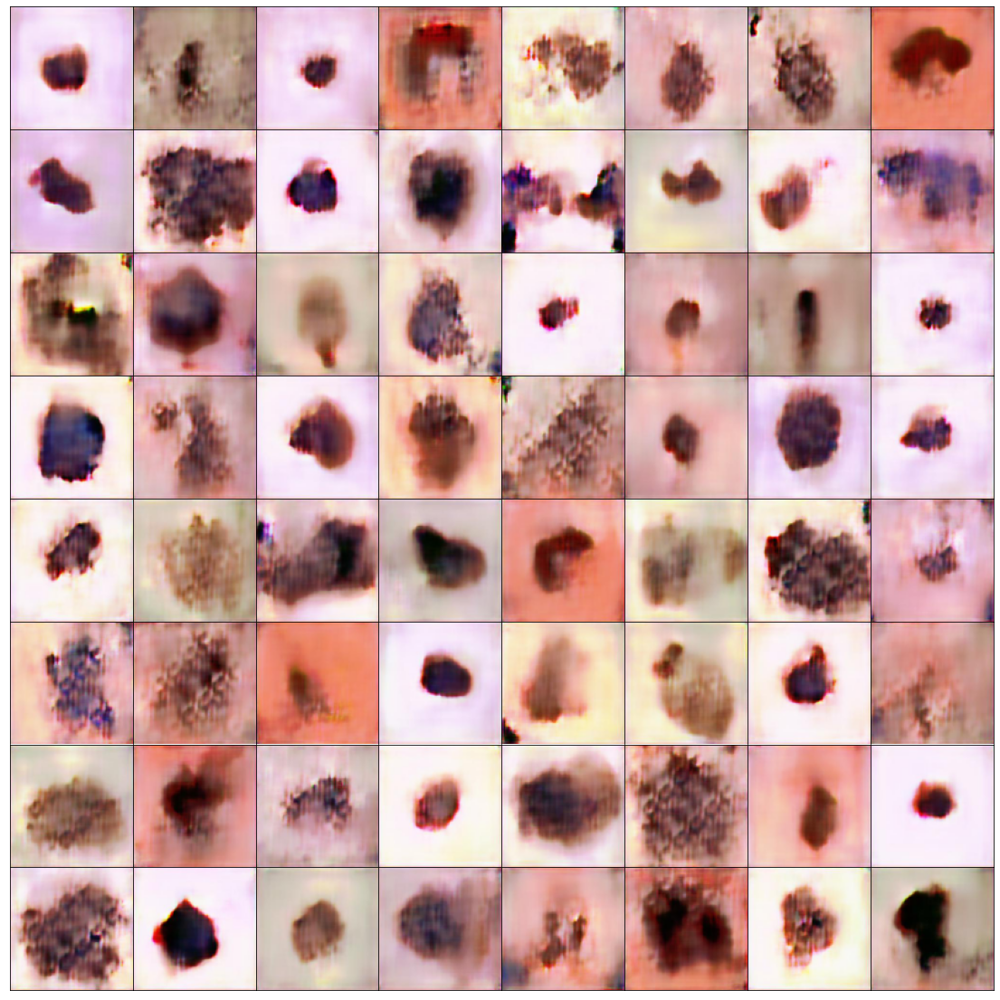

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import numpy as np

fig = plt.figure(figsize=(20., 20.))
grid = ImageGrid(fig, 111, 
                 nrows_ncols=(8, 8),  # creates 2x2 grid of axes
                 axes_pad=1,  # pad between axes
                 )

for ax, im in zip(grid, img_path_list):
    img = Image.open(im).convert('RGB')
    img = img.resize((100,100))
    img = np.asarray(img)
    ax.imshow(img)
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)

plt.show()


# 50

In [ ]:
root_dir = '/content/drive/MyDrive/ProGAN/malignant__samples/grid'
img_path_list = []
possible_img_extension = ['.jpg', '.jpeg', '.JPG', '.bmp', '.png'] # 이미지 확장자들
 
for (root, dirs, files) in os.walk(root_dir):
    if len(files) > 0:
        for file_name in files:
            if os.path.splitext(file_name)[1] in possible_img_extension:
                img_path = root + '/' + file_name
                
                # 경로에서 \를 모두 /로 바꿔줘야함
                img_path = img_path.replace('\\', '/') # \는 \\로 나타내야함         
                img_path_list.append(img_path)
                             
print(img_path_list)

[]


In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
from PIL import Image
import numpy as np

fig = plt.figure(figsize=(20., 20.))
grid = ImageGrid(fig, 111, 
                 nrows_ncols=(8, 8),  # creates 2x2 grid of axes
                 axes_pad=0,  # pad between axes
                 )

for ax, im in zip(grid, img_path_list):
    img = Image.open(im).convert('RGB')
    img = img.resize((100,100))
    img = np.asarray(img)
    ax.imshow(img)
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)

plt.show()


Output hidden; open in https://colab.research.google.com to view.

In [5]:
root_dir = '/content/drive/MyDrive/ProGAN/malignant_10_samples/grid'
img_path_list = []
possible_img_extension = ['.jpg', '.jpeg', '.JPG', '.bmp', '.png'] # 이미지 확장자들
 
for (root, dirs, files) in os.walk(root_dir):
    if len(files) > 0:
        for file_name in files:
            if os.path.splitext(file_name)[1] in possible_img_extension:
                img_path = root + '/' + file_name
                
                # 경로에서 \를 모두 /로 바꿔줘야함
                img_path = img_path.replace('\\', '/') # \는 \\로 나타내야함         
                img_path_list.append(img_path)
                             
print(img_path_list)

NameError: ignored

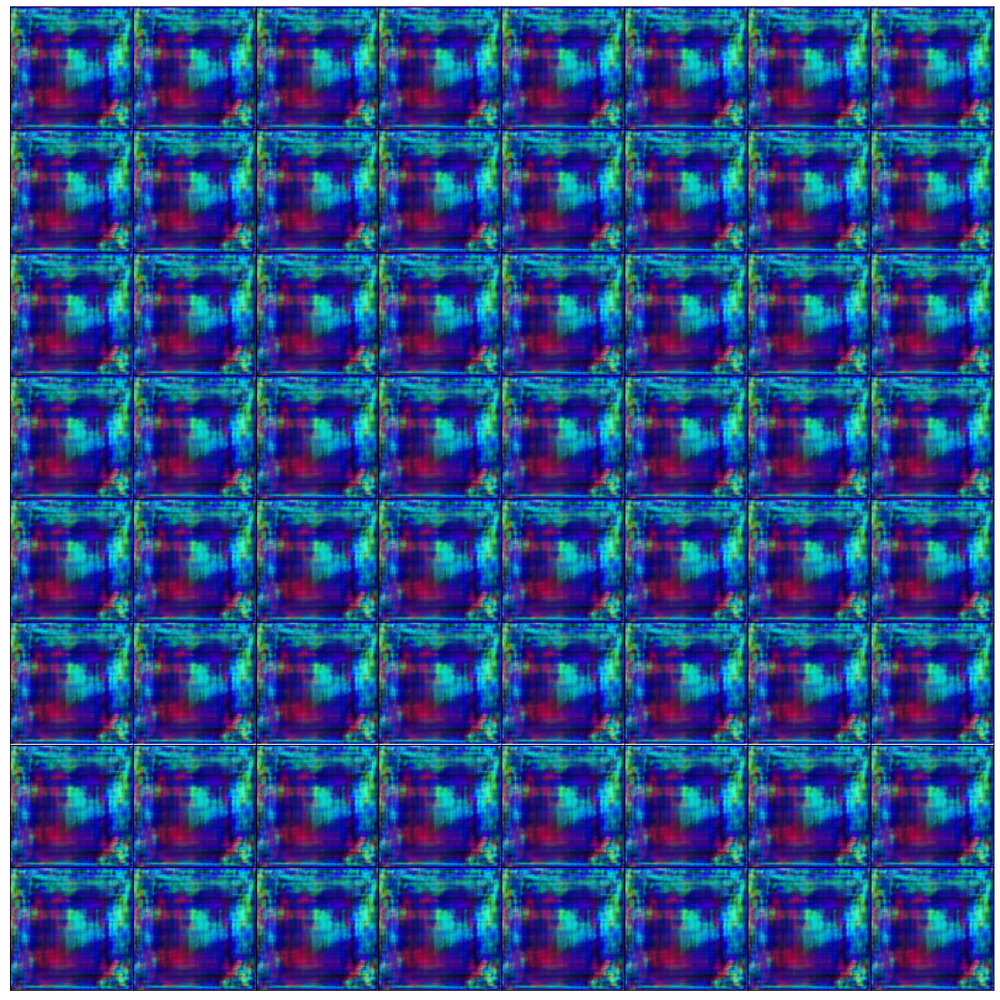

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
from PIL import Image
import numpy as np

fig = plt.figure(figsize=(20., 20.))
grid = ImageGrid(fig, 111, 
                 nrows_ncols=(8, 8),  # creates 2x2 grid of axes
                 axes_pad=0,  # pad between axes
                 )
for im in img_path_list:
  for ax in grid:
    img = Image.open(im).convert('RGB')
    img = img.resize((100,100))
    img = np.asarray(img)
    ax.imshow(img)
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)

plt.show()


# Make image

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as img

In [4]:
image = img.imread('/content/drive/MyDrive/ProGAN/1300.png')
plt.figure(figsize = (9,9))
ax = plt.gca()
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

plt.title('Fake Malignant Images')
plt.imshow(image)

FileNotFoundError: ignored